# Final Project - An Old Fashioned Way of Leaf Classification
**Tian-Lai (Leo) Chen**

tc289

Import essential libraries for this project

In [355]:
import cv2
from skimage import filters
from skimage.morphology import square, opening
from skimage.color import rgb2gray
from skimage.color import gray2rgb
from scipy import ndimage
import numpy as np
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
import pandas as pd
import os
from skimage.transform import resize
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
from skimage import img_as_float
from skimage.transform import resize

from skimage import feature, exposure

from skimage import filters
from skimage.morphology import disk, erosion
from skimage.color import rgb2gray
from skimage.color import gray2rgb
from scipy import ndimage

from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

from sklearn.ensemble import RandomForestClassifier

from sklearn import preprocessing
from sklearn import metrics
import seaborn as sns

In [2]:
os.getcwd()

'/root'

# Load Image Data

This section is designed to load data from folders.

In [3]:
Categories= ['pubescent bamboo', 'Chinese horse chestnut', 'Anhui Barberry', 'Chinese redbud',
          'true indigo', 'Japanese maple', 'Nanmu', 'castor aralia', 
          'Chinese cinnamon', 'goldenrain tree', 'Big-fruited Holly', 'Japanese cheesewood','wintersweet','camphortree',
             'Japan Arrowwood','sweet osmanthus','deodar',
            'ginkgo','Crape myrtle','oleander','yew plum pine','Japanese Flowering Cherry','Glossy Privet',
            'Chinese Toon','peach','Ford Woodlotus','trident maple','Beale barberry','southern magnolia','Canadian poplar',
            'Chinese tulip tree','tangerine']

In [4]:
len(Categories)

32

In [5]:
# Read from folders and label each image with integer

folder = list(range(1,33))
folder = [ str(x) for x in folder ]
flat_data_arr=[] #input array
target_arr=[] #output array
datadir=os.getcwd()+'/autodl-nas/leaves'
#path which contains all the categories of images
for i in folder:
    
    print(f'loading... category : {i}')
    path=os.path.join(datadir,i)
    for img in os.listdir(path):
        img_array=plt.imread(os.path.join(path,img))
        img_resized=cv2.resize(img_array,(400,300)).flatten()
        flat_data_arr.append(img_resized)
        target_arr.append(folder.index(i))
    print(f'loaded category:{i} successfully')

loading... category : 1
loaded category:1 successfully
loading... category : 2
loaded category:2 successfully
loading... category : 3
loaded category:3 successfully
loading... category : 4
loaded category:4 successfully
loading... category : 5
loaded category:5 successfully
loading... category : 6
loaded category:6 successfully
loading... category : 7
loaded category:7 successfully
loading... category : 8
loaded category:8 successfully
loading... category : 9
loaded category:9 successfully
loading... category : 10
loaded category:10 successfully
loading... category : 11
loaded category:11 successfully
loading... category : 12
loaded category:12 successfully
loading... category : 13
loaded category:13 successfully
loading... category : 14
loaded category:14 successfully
loading... category : 15
loaded category:15 successfully
loading... category : 16
loaded category:16 successfully
loading... category : 17
loaded category:17 successfully
loading... category : 18
loaded category:18 succe

In [6]:
# convert image data into a dataframe

flat_data = np.array(flat_data_arr)
target = np.array(target_arr)
df = pd.DataFrame(flat_data) #dataframe


In [7]:
df['Target']=target

In [7]:
df

,0,1,2,3,4,5,6,7,8,9,...,359991,359992,359993,359994,359995,359996,359997,359998,359999,Target
0,239,246,239,248,252,248,253,255,254,255,...,255,255,255,255,255,255,255,255,255,0
1,238,239,238,254,255,254,255,255,255,254,...,255,255,255,255,255,255,255,255,255,0
2,251,252,252,255,255,255,255,255,255,255,...,255,255,255,255,255,255,255,255,255,0
3,252,255,255,255,255,255,255,255,255,255,...,255,255,255,255,255,255,255,255,255,0
4,255,255,255,255,255,255,255,255,255,255,...,255,255,255,255,255,255,255,255,255,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1902,255,255,255,255,255,255,255,255,255,255,...,255,255,255,255,255,255,255,255,255,31
1903,255,255,255,255,255,255,255,255,255,255,...,255,255,255,255,255,255,255,255,255,31
1904,255,255,255,255,255,255,255,255,255,255,...,255,255,255,255,255,255,255,255,255,31
1905,255,255,255,255,255,255,255,255,255,255,...,255,255,255,255,255,255,255,255,255,31


In [8]:
Categories[30]

'tangerine'

Below shows 32 classes of leaves.

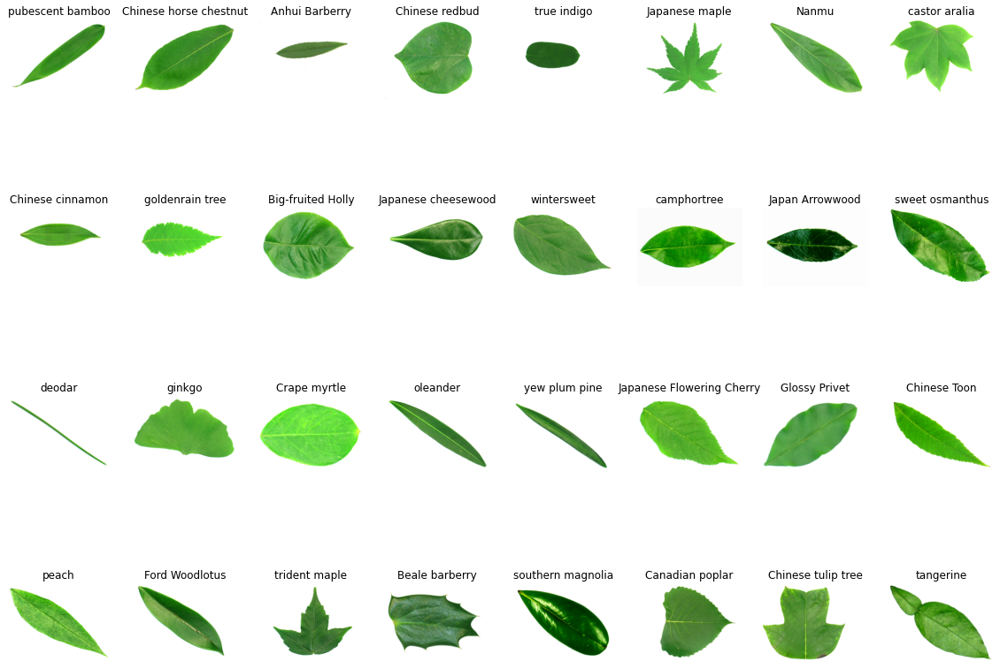

In [124]:
# Plot example for 32 classes 
plt.figure(figsize=(20, 15))
for i in range(0,32):
    img = df.loc[df['Target'] == i].iloc[:,:-1].iloc[i]
    img = np.array(img).reshape(300,400,3)
    ax = plt.subplot(4, 8, i + 1)
    plt.imshow(img)
    plt.title(Categories[i])
    plt.axis("off")

plt.savefig("raw_data.svg")

In [ ]:
# df = pd.read_csv('./autodl-nas/raw_data.csv')

In [8]:
x=df.iloc[:,:-1] #input data 
y=df.iloc[:,-1] #output data

**Split train and test data**

In [9]:
Xtrain,Xtest,ytrain,ytest = train_test_split(x,y,random_state =0,test_size=0.3,stratify = y)

### Image Augmentation

After train/test split, one could perfrom image augmentation with horizental and vertical flip.

In [10]:
import random
import albumentations as A

In [11]:
def img_convert(vec):
    '''The function convert flatten vector into image'''
    return vec.reshape(300,400,3)

In [12]:
def img_augmented(X,y):
    '''
    The function takes set of image data and corresponding labels, and produce augmented version.
    
    -X: array of flatten image 
    -y correspoding label array
    
    Output:
    -X_new: list
    -y_new: list
    '''
    
    X_arr = np.array(X)
    y_arr = np.array(y)
    X_new = []
    y_new = []
    for i in range(np.array(X_arr).shape[0]):
        j = X_arr[i]
        X_new.append(j)
        img = img_convert(j)
        y_new.append(y_arr[i])
        
        transform = A.VerticalFlip(p=1)
        random.seed(0)
        augmented_image = transform(image=img)['image']
        X_new.append(augmented_image.flatten())
        y_new.append(y_arr[i])
        
        transform = A.HorizontalFlip(p=1)
        augmented_image = transform(image=img)['image']
        X_new.append(augmented_image.flatten())
        y_new.append(y_arr[i])
    return X_new, y_new


In [15]:
np.array(Xtrain).shape[0]

1334

**Perform augmentation here**

In [13]:
X_train_ag, y_train = img_augmented(Xtrain,ytrain)

In [17]:
len(y_train)

4002

In [231]:
X_test_ag, y_test = img_augmented(Xtest,ytest)

An example of vertical and horizental flip

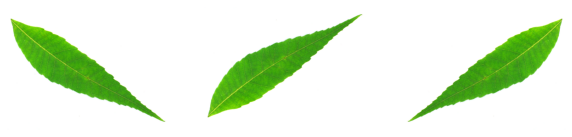

In [128]:
plt.figure(figsize=(10,10))

plt.subplot(1,3,1)
plt.imshow(img_convert(X_train_ag[3]))
plt.axis("off")
plt.subplot(1,3,2)
plt.imshow(img_convert(X_train_ag[4]))
plt.axis("off")

plt.subplot(1,3,3)
plt.imshow(img_convert(X_train_ag[5]))
plt.axis("off")

plt.savefig('augmented_example.svg')

# Buid Model

In [238]:
import time

### Baseline Training Model

With the augmented sets, next is to build baseline models: Random Forest Classifier and ResNet50.

In [306]:
clf_base = RandomForestClassifier(random_state=0)
clf_base.fit(X_train_ag, y_train)


RandomForestClassifier(random_state=0)

In [ ]:
ypred_base = clf_base.predict(X_test_ag)

In [307]:
# This section is designed for time measurement
# Compute 100 iterations and take average to reduce randomness
t=0
for i in range(100):
    t1 = time.time()
    ypred_base = clf_base.predict(X_test_ag)
    t2 = time.time()
    t+= (t2-t1)
print(t/100)

2.8523857593536377


In [308]:
print(classification_report(y_test, ypred_base))

              precision    recall  f1-score   support

           0       0.93      0.94      0.94        54
           1       0.75      0.79      0.77        57
           2       0.89      0.88      0.88        57
           3       0.89      0.95      0.92        66
           4       0.95      0.94      0.95        66
           5       0.82      0.90      0.86        51
           6       0.82      0.88      0.85        57
           7       1.00      0.96      0.98        48
           8       0.64      0.73      0.68        48
           9       0.89      0.94      0.92        54
          10       0.88      0.78      0.82        45
          11       0.93      0.96      0.95        57
          12       0.75      0.79      0.77        48
          13       0.96      0.78      0.86        60
          14       0.84      1.00      0.92        54
          15       0.83      0.67      0.74        51
          16       0.97      1.00      0.99        69
          17       0.83    

### ResNet50

Use pretrained ResNet50 for transform learning

In [115]:
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50

In [116]:
# Encode label into one-hot vector for deep learning
label_binarizer = preprocessing.LabelBinarizer()
label_binarizer.fit(range(32))
y_train_encoded = label_binarizer.transform(y_train)
y_test_encoded = label_binarizer.transform(y_test)

In [117]:
y_train_encoded[0].shape

(32,)

In [118]:
# Convert flatten image vaector back to image of 400x300x3

X_train_net =  []

for i in X_train_ag:
    i = img_convert(i)
    i = cv2.resize(i,(224,224))
    X_train_net.append(i/255.0)
    
X_train_net = np.array(X_train_net)

X_test_net =  []

for i in X_test_ag:
    i = img_convert(i)
    i = cv2.resize(i,(224,224))
    X_test_net.append(i/255.0)
    
X_test_net = np.array(X_test_net)

In [119]:
from tensorflow.keras import layers
from tensorflow.keras import Model

In [120]:

base_model = ResNet50(weights="imagenet",include_top=False)
for layer in base_model.layers:
    layer.trainable = False   
avg = layers.GlobalAveragePooling2D()(base_model.output)
# Three dense layers are added here to relax the decrease of parameters
l1 = layers.Dense(1024, activation="relu")(avg)
l2 = layers.Dense(512, activation="relu")(l1)
l3 = layers.Dense(128, activation="relu")(l2)
output = layers.Dense(32, activation="softmax")(l3)

# combine the two parts
model = Model(inputs=base_model.input, outputs=output)

model.compile(loss="categorical_crossentropy", 
              optimizer=tf.keras.optimizers.Adam(0.0001),
              metrics=["accuracy"])
model.fit(X_train_net,np.array(y_train_encoded),
      epochs=300,batch_size=40)

2022-05-07 03:42:53.384525: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-05-07 03:42:54.854548: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 22308 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:84:00.0, compute capability: 8.6
2022-05-07 03:42:59.238281: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 2409652224 exceeds 10% of free system memory.
2022-05-07 03:43:01.629020: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 2409652224 exceeds 10% of free system memory.


Epoch 1/300


2022-05-07 03:43:09.784358: I tensorflow/stream_executor/cuda/cuda_dnn.cc:366] Loaded cuDNN version 8200


  3/101 [..............................] - ETA: 4s - loss: 3.5902 - accuracy: 0.0000e+00   

2022-05-07 03:43:15.028554: I tensorflow/stream_executor/cuda/cuda_blas.cc:1774] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


101/101 [==============================] - 16s 43ms/step - loss: 3.3836 - accuracy: 0.0802
Epoch 2/300
101/101 [==============================] - 4s 42ms/step - loss: 3.0689 - accuracy: 0.1819
Epoch 3/300
101/101 [==============================] - 4s 42ms/step - loss: 2.7225 - accuracy: 0.2509
Epoch 4/300
101/101 [==============================] - 4s 43ms/step - loss: 2.4304 - accuracy: 0.3203
Epoch 5/300
101/101 [==============================] - 4s 43ms/step - loss: 2.2092 - accuracy: 0.3673
Epoch 6/300
101/101 [==============================] - 5s 45ms/step - loss: 2.0136 - accuracy: 0.4243
Epoch 7/300
101/101 [==============================] - 4s 43ms/step - loss: 1.8746 - accuracy: 0.4473
Epoch 8/300
101/101 [==============================] - 4s 42ms/step - loss: 1.7328 - accuracy: 0.4993
Epoch 9/300
101/101 [==============================] - 5s 46ms/step - loss: 1.6059 - accuracy: 0.5372
Epoch 10/300
101/101 [==============================] - 5s 45ms/step - loss: 1.5091 - accurac

In [122]:
model.evaluate(X_test_net,np.array(y_test_encoded),batch_size=20)

86/86 [==============================] - 3s 30ms/step - loss: 0.3292 - accuracy: 0.9069


[0.3292043209075928, 0.9069226384162903]

In [245]:
t=0
for i in range(100):
    t1 = time.time()
    ypred = model.predict(X_test_net,batch_size=40)
    t2 = time.time()
    t+= (t2-t1)
print(t/100)

6.21516489982605


In [89]:
model.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_8 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_8[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                         

## Image Pre-Processing

### Background Removel

Only after the background is removed, then Fourier descriptor for example can capture the shape of leaves.

In [15]:
def background_substract(img):
    '''
    Input:
    -img: 400*300*3 image
    
    Ouput:
    -re: image without white background
    '''
    
    gray = rgb2gray(img)

    gray_lp  = ndimage.gaussian_filter(gray, sigma=0.5)

    otsu = filters.threshold_otsu(gray_lp)
    bw = (gray_lp > otsu)

    selem = disk(2)
    ero = erosion(bw, selem)

    mask = ero
    boolean = 1- mask>0
    re = np.zeros_like(img,np.uint8)
    re[boolean] = img[boolean]

    
    return re

In [33]:
def background_substract_data(X):
    '''
    wrapper function for background subtract
    Take list of flatten image data and produce flatten image data without background
    '''
    X_arr = np.array(X)
    X_new = []
    num = 0
    for i in X_arr:
        X_new.append(background_substract(img_convert(i)).flatten())
        num +=1
        # print(num)
        if num ==4002:
            print('done')
    return X_new

**32 Claases of plant leaves without Background**

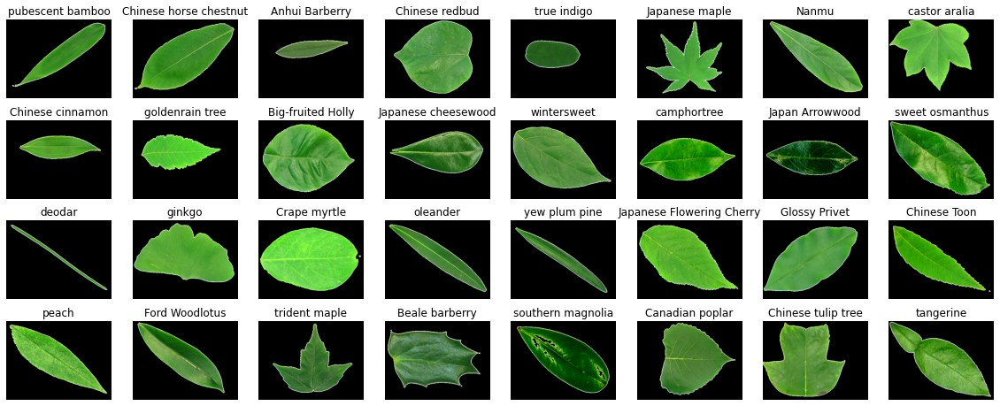

In [255]:
plt.figure(figsize=(20, 8))
for i in range(0,32):
    img = df.loc[df['Target'] == i].iloc[:,:-1].iloc[i]
    img = np.array(img).reshape(300,400,3)
    img = background_substract(img)
    ax = plt.subplot(4, 8, i + 1)
    plt.imshow(img)
    plt.title(Categories[i])
    plt.axis("off")

plt.savefig('br_all.svg')

**Remove background for train and test sets respectively**

In [34]:
X_br_train = background_substract_data(X_train_ag)
X_br_test = background_substract_data(X_test_ag)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


**A ramdom Forest classifier over br sets**

In [249]:
clf_br = RandomForestClassifier(random_state=0)
clf_br.fit(X_br_train, y_train)

RandomForestClassifier(random_state=0)

In [252]:
ypred_br = clf_br.predict(X_br_test)

In [253]:
print(classification_report(y_test, ypred_br))

              precision    recall  f1-score   support

           0       0.92      0.89      0.91        54
           1       0.70      0.74      0.72        57
           2       0.85      0.82      0.84        57
           3       0.87      0.98      0.92        66
           4       0.87      0.92      0.90        66
           5       0.88      0.88      0.88        51
           6       0.81      0.89      0.85        57
           7       1.00      0.94      0.97        48
           8       0.56      0.67      0.61        48
           9       0.88      0.98      0.93        54
          10       0.97      0.64      0.77        45
          11       0.87      0.84      0.86        57
          12       0.86      0.90      0.88        48
          13       0.76      0.80      0.78        60
          14       0.79      1.00      0.89        54
          15       0.81      0.69      0.74        51
          16       0.96      1.00      0.98        69
          17       0.84    

### Example

Below shows each intermidiate step of background removal

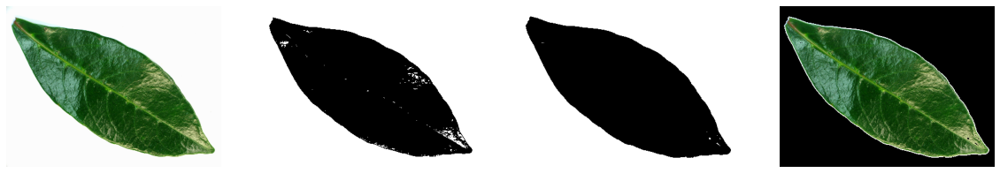

In [138]:
img = img_convert(X_train_ag[100])

gray = rgb2gray(img)

gray_lp  = ndimage.gaussian_filter(gray, sigma=0.5)

otsu = filters.threshold_otsu(gray_lp)
bw = (gray_lp > otsu)

selem = disk(2)
ero = erosion(bw, selem)

mask = ero
boolean = 1- mask>0
re = np.zeros_like(img,np.uint8)
re[boolean] = img[boolean]

plt.figure(figsize=(20,20))

plt.subplot(1,4,1)
plt.imshow(img)
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(bw,cmap='gray')
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(ero,cmap='gray')
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(re)
plt.axis("off")

plt.savefig('br_example.svg')

## Feature Extraction

This section has three feature extraction methods: fourier descritor, Hu's moments, and Local Binary Pattern

In [16]:
def compute_FD(img):
    '''
    Take image as input and produce 100 fourier descrpitors
    '''
    gray  = rgb2gray(img)

    otsu = filters.threshold_otsu(gray)
    bw = (gray > otsu)

    con,hierarchy=cv2.findContours(np.uint8(bw), cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE) #only unit 8
    # We only need the longest one
    m = 0
    if len(con)>1:
        for i in con:
            if len(i)>m:
                cont = [i]
                m = len(i)
    else:
        cont = con
        
    FD = np.zeros([1,100],dtype=complex)
    
    for i in range(len(cont)):        
        v=np.zeros([len(cont[i])],dtype=complex)   
        for j in range(0,len(cont[i])):
            v[j]= cont[i][:,0][j,0]+1j*cont[i][:,0][j,1]

        FD[i,:]=np.fft.fft(v)[0:100]
    
    X = preprocessing.normalize(np.absolute(FD[:,1:100])/v.shape[0])
    return X

In [17]:
def compute_hu(img):
    '''
    Take image as input and produce 7 Hu's moments
    '''
    ig = rgb2gray(img)
    moments = np.abs(cv2.HuMoments(cv2.moments(ig)).flatten())
    moments = moments/np.max(moments) 
    return moments


In [261]:
def compute_lbp(img):
    '''
    Take image as input and produce 10 LBP histgram
    '''
    gray  = rgb2gray(img)
    
    lbp = feature.local_binary_pattern(gray,8,1,method='uniform') # use uniform mode

    n_bins = int(lbp.max()+1 ) # consider uniform value
    hist, _ = np.histogram(lbp, density=True, bins=n_bins, range=(0, n_bins))
    return hist

#### example

In [262]:
img = img_convert(X_train_ag[0])
hist = compute_lbp(img)
hist

array([0.05023333, 0.04014167, 0.02456667, 0.037325  , 0.04736667,
       0.05280833, 0.02674167, 0.04655833, 0.58895833, 0.0853    ])

In [260]:
img = img_convert(X_train_ag[0])
hist = compute_lbp(img)
hist

array([0.05023333, 0.04014167, 0.02456667, 0.037325  , 0.04736667,
       0.05280833, 0.02674167, 0.04655833, 0.67425833])

In [28]:
img.shape

(300, 400, 3)

#### Feature Extraction Function

In [48]:
def feature_extract(img,mode='all'):
    '''
    Call three feature extraction functions via modes
    '''
    if mode =='fd':
        FD = compute_FD(img)
        return FD
    if mode =='hu':
        moments = compute_hu(img)
        return moments
    if mode =='lbp':
        lbp = compute_lbp(img)
        return lbp
    if mode=="all":
        FD = compute_FD(img)
        moments = compute_hu(img)
        lbp = compute_lbp(img)
        arr = np.append(moments,lbp)
        arr = np.append(arr,FD)
    
        return arr

In [351]:
def feature_extract_data(X,mode="all"):
    '''
    wrapper function to extract features for whole data list
    '''
    X_arr = np.array(X)
    X_new = []
    num = 0
    for i in X_arr:
        X_new.append(feature_extract(img_convert(i),mode=mode))
        num +=1
        # if num - (num //1000)*1000 ==0:
        #     print('1000 data have been converted')
    return X_new

### Construct New Train and Test Set

New sets are 117 long with three different features

In [267]:
X_new_train = feature_extract_data(X_br_train)
X_new_test = feature_extract_data(X_br_test)

1000 data have been converted
1000 data have been converted
1000 data have been converted
1000 data have been converted
1000 data have been converted


In [84]:
X_new_train[0]

array([1.00000000e+00, 2.51646492e-01, 6.63560659e-03, 1.06138560e-03,
       1.34366581e-06, 3.66891171e-04, 4.02435171e-07, 3.04750000e-02,
       1.58666667e-02, 6.71666667e-03, 3.63333333e-03, 2.94166667e-03,
       2.61666667e-03, 2.68333333e-03, 2.92500000e-03, 3.92500000e-03,
       4.85833333e-03, 6.56666667e-03, 9.10000000e-03, 1.18333333e-02,
       9.28333333e-03, 6.48333333e-03, 4.66666667e-03, 3.85000000e-03,
       3.17500000e-03, 2.80833333e-03, 3.04166667e-03, 3.22500000e-03,
       4.62500000e-03, 7.90000000e-03, 1.49500000e-02, 5.81908333e-01,
       2.49941667e-01, 9.85743518e-01, 1.13342581e-01, 1.06466826e-01,
       3.25438953e-02, 4.38846609e-02, 2.09069860e-02, 1.93322670e-02,
       6.19992024e-03, 1.11990725e-02, 3.88009531e-03, 7.28648237e-03,
       4.53217185e-03, 6.50254513e-03, 3.05413415e-03, 2.63173292e-03,
       9.95321157e-04, 2.53672429e-03, 8.79026278e-04, 1.39878178e-03,
       1.06322864e-03, 1.54114356e-03, 5.53143134e-04, 4.59756548e-04,
      

In [25]:
df_train = pd.DataFrame(X_new_train)
df_test = pd.DataFrame(X_new_test)

In [66]:
df_train

,0,1,2,3,4,5,6,7,8,9,...,121,122,123,124,125,126,127,128,129,130
0,1.0,0.023861,0.000367,0.000323,2.253155e-08,2.400301e-05,1.775722e-08,0.021692,0.013225,0.006142,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0
1,1.0,0.023861,0.000367,0.000323,2.253155e-08,2.400301e-05,1.775722e-08,0.021692,0.013225,0.006142,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0
2,1.0,0.023861,0.000367,0.000323,2.253155e-08,2.400301e-05,1.775722e-08,0.021692,0.013225,0.006142,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0
3,1.0,0.014909,0.000023,0.000076,5.408925e-10,4.051661e-06,3.746912e-10,0.012775,0.006467,0.003192,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0
4,1.0,0.014909,0.000023,0.000076,5.408925e-10,4.051661e-06,3.746912e-10,0.012775,0.006467,0.003192,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3997,1.0,0.023994,0.000055,0.000166,5.413222e-10,3.050319e-06,4.052020e-09,0.028942,0.017767,0.006883,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0
3998,1.0,0.023994,0.000055,0.000166,5.413222e-10,3.050319e-06,4.052020e-09,0.028942,0.017767,0.006883,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0
3999,1.0,0.016344,0.000007,0.000006,1.387365e-13,2.673996e-07,7.488592e-12,0.014833,0.008233,0.002625,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0
4000,1.0,0.016344,0.000007,0.000006,1.387365e-13,2.673996e-07,7.488592e-12,0.014833,0.008233,0.002625,...,0.000455,0.0,0.000537,3.494072e-17,0.000647,0.0,0.000217,5.362639e-17,0.000689,0.0


### Illustrative Example

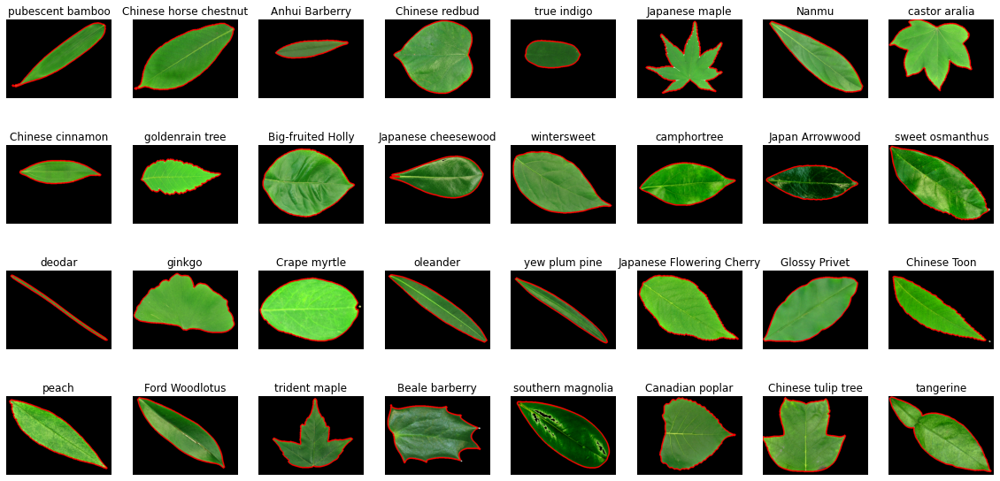

In [150]:
# Fourier Example

plt.figure(figsize=(20, 10))
for i in range(0,32):
    img = df.loc[df['Target'] == i].iloc[:,:-1].iloc[i]
    img = np.array(img).reshape(300,400,3)
    img = background_substract(img)
    gray  = rgb2gray(img)

    otsu = filters.threshold_otsu(gray)
    bw = (gray > otsu)

    con,hierarchy=cv2.findContours(np.uint8(bw), cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE) #only unit 8
    m = 0
    if len(con)>1:
        for ii in con:
            if len(ii)>m:
                cont = ii
                m = len(ii)
    else:
        cont = con

    image_plus = cv2.drawContours(img , cont, 
                              -1,                # index of contour to draw, -1 means all
                              (255,0,0),         # color of contour
                              4                  # thickness of line
                             )

    ax = plt.subplot(4, 8, i + 1)
    plt.imshow(image_plus, cmap=plt.cm.gray)
    plt.title(Categories[i])
    plt.axis("off")

plt.savefig('fd_all.svg')

In [ ]:
# LBP

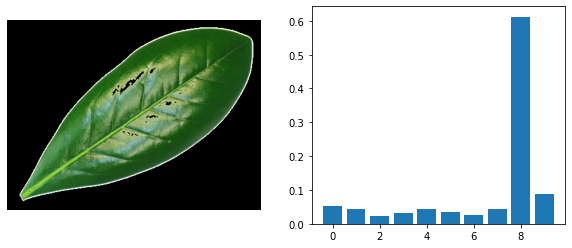

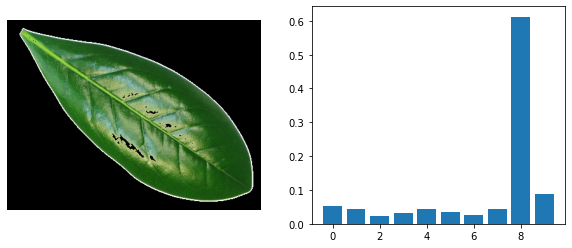

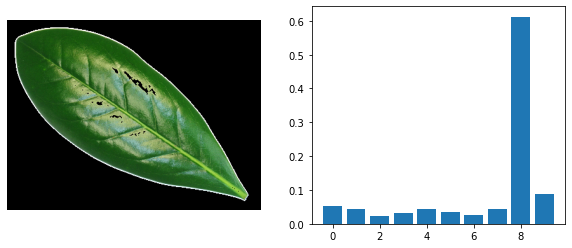

In [276]:
a=[]
for i in [0,1,2]:
    img = img_convert(X_train_ag[i])
    img = background_substract(img)
    his = compute_lbp(img)
    plt.figure(figsize=(10, 4))
    ax = plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    ax = plt.subplot(1, 2, 2)
    plt.bar(list(range(10)),his)
    his2 = his
    a.append(his)
    plt.savefig('1_'+str(i)+'_lbp.svg')

Check is these three images have same LBP value

In [277]:
a[0]==a[1]

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True])

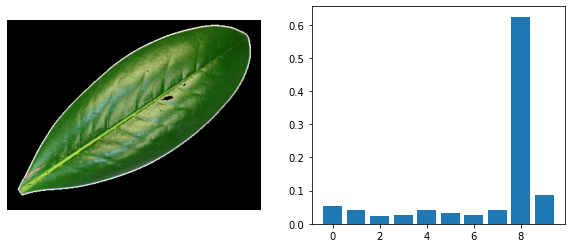

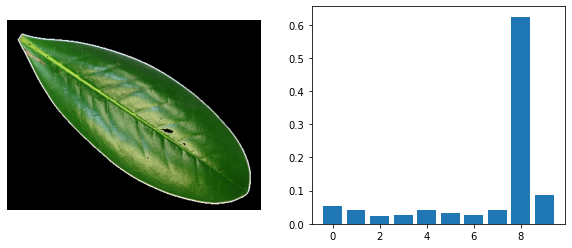

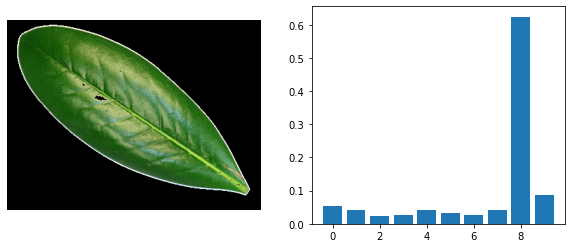

In [275]:

for i in [549,550,551]:
    img = img_convert(X_train_ag[i])
    img = background_substract(img)
    his = compute_lbp(img)
    plt.figure(figsize=(10, 4))
    ax = plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    ax = plt.subplot(1, 2, 2)
    plt.bar(list(range(10)),his)
    his1=his
    plt.savefig('1_'+str(i)+'_lbp.svg')

Check two leaveas have same LBP value

In [273]:
his1

array([0.05268333, 0.04270833, 0.02355   , 0.02768333, 0.04051667,
       0.03194167, 0.02693333, 0.04205833, 0.62461667, 0.08730833])

In [274]:
his2

array([0.05278333, 0.04380833, 0.02396667, 0.030625  , 0.04440833,
       0.03504167, 0.02585   , 0.04246667, 0.61221667, 0.08883333])

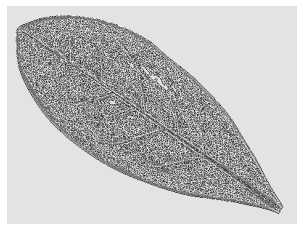

In [282]:
gray  = rgb2gray(img)
lbp = feature.local_binary_pattern(gray,8,1,method='uniform')
plt.imshow(lbp,cmap='gray')
plt.axis('off')
plt.savefig('LBPExample.svg')

In [ ]:
# Hu

[1.00000000e+00 2.51646492e-01 6.63560659e-03 1.06138560e-03
 1.34366581e-06 3.66891171e-04 4.02435171e-07]
[1.00000000e+00 2.51646492e-01 6.63560659e-03 1.06138560e-03
 1.34366581e-06 3.66891171e-04 4.02435171e-07]
[1.00000000e+00 2.51646492e-01 6.63560659e-03 1.06138560e-03
 1.34366581e-06 3.66891171e-04 4.02435171e-07]


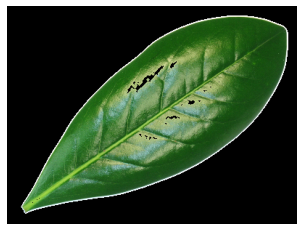

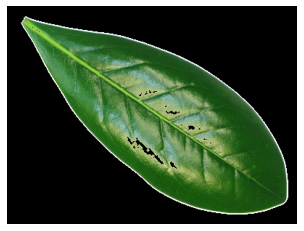

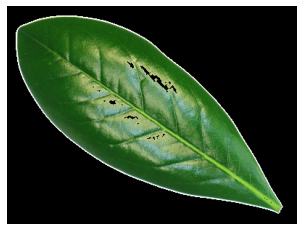

In [280]:
for i in [0,1,2]:
    img = img_convert(X_br_train[i])
    m = compute_hu(img)
    print(m)

    plt.figure(figsize=(10, 4))
    plt.imshow(img)
    plt.axis('off')

    plt.savefig('1_'+str(i)+'_Hu.svg')

### Random Forest on Fourier Descriptors

Apply RFC on FD alone

In [356]:
X_FD_train = feature_extract_data(X_br_train,mode='fd')
X_FD_test = feature_extract_data(X_br_test,mode='fd')

In [81]:
len(X_FD_test)

1719

In [199]:
clf_new = RandomForestClassifier(random_state=0)
clf_new.fit(np.array(X_FD_train).reshape(4002,99), y_train)

RandomForestClassifier(random_state=0)

In [200]:
ypred = clf_new.predict(np.array(X_FD_test).reshape(1719,99))
print(classification_report(y_test, ypred))

              precision    recall  f1-score   support

           0       0.88      0.78      0.82        54
           1       0.57      0.89      0.69        57
           2       0.53      0.84      0.65        57
           3       0.91      0.95      0.93        66
           4       0.91      0.91      0.91        66
           5       0.93      0.82      0.87        51
           6       0.44      0.63      0.52        57
           7       0.93      0.88      0.90        48
           8       0.46      0.38      0.41        48
           9       0.78      1.00      0.88        54
          10       0.71      0.67      0.69        45
          11       0.78      0.95      0.86        57
          12       0.68      0.81      0.74        48
          13       0.88      0.75      0.81        60
          14       0.53      0.50      0.51        54
          15       0.75      0.35      0.48        51
          16       0.92      0.96      0.94        69
          17       0.90    

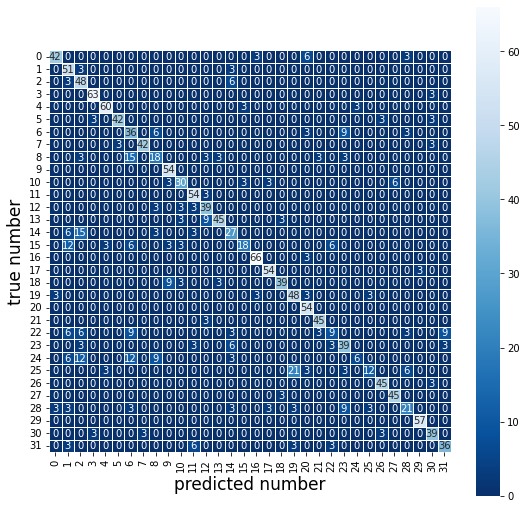

In [201]:
cm1 = metrics.confusion_matrix(y_test, ypred)

plt.figure(figsize=(9,9))
sns.heatmap(cm1, annot=True, fmt=".0f", linewidths=.5, square=True, cmap='Blues_r')
plt.ylabel('true number', size=17)
plt.xlabel('predicted number', size=17)
plt.show()

total number of errors: 435


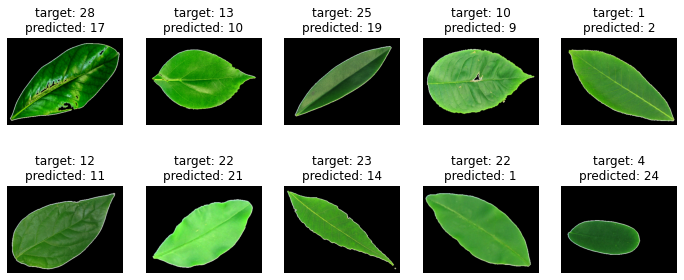

<Figure size 432x288 with 0 Axes>

In [215]:

errors = (y_test-ypred != 0)
error_pos = np.array(np.where(errors))
print('total number of errors:', len(error_pos[0,:]))

# show the errors
plt.figure(figsize=(12,5))
x, y =5, 2
num=0
for i in range(1,30,3):  
    num+=1
    plt.subplot(y, x, num)
    idx = error_pos[0,i] 
    plt.imshow(X_br_test[idx].reshape(300,400,3),cmap='gray')
    plt.title('target: {}\npredicted: {}'.format(y_test[idx], ypred[idx]))
    plt.axis('off')
plt.show()
plt.savefig('FD_err.svg')

### Random Forest on Hu's moment 

In [263]:
X_hu_train = feature_extract_data(X_br_train,mode='hu')
X_hu_test = feature_extract_data(X_br_test,mode='hu')


1000 data have been converted
1000 data have been converted
1000 data have been converted
1000 data have been converted
1000 data have been converted


In [87]:

clf_new = RandomForestClassifier(random_state=0)
clf_new.fit(X_hu_train, y_train)

RandomForestClassifier(random_state=0)

In [88]:
ypred = clf_new.predict(X_hu_test)
print(classification_report(y_test, ypred))

              precision    recall  f1-score   support

           0       0.89      0.94      0.92        54
           1       0.32      0.47      0.38        57
           2       0.25      0.32      0.28        57
           3       0.75      0.68      0.71        66
           4       0.29      0.27      0.28        66
           5       0.80      0.94      0.86        51
           6       0.44      0.42      0.43        57
           7       0.71      0.75      0.73        48
           8       0.20      0.19      0.19        48
           9       0.44      0.44      0.44        54
          10       0.64      0.60      0.62        45
          11       0.59      0.84      0.70        57
          12       0.33      0.25      0.29        48
          13       0.06      0.05      0.06        60
          14       0.40      0.33      0.36        54
          15       0.56      0.53      0.55        51
          16       1.00      1.00      1.00        69
          17       0.61    

### Random Forest on LBP

In [264]:
X_lbp_train = feature_extract_data(X_br_train,mode='lbp')
X_lbp_test = feature_extract_data(X_br_test,mode='lbp')

1000 data have been converted
1000 data have been converted
1000 data have been converted
1000 data have been converted
1000 data have been converted


In [265]:

clf_new = RandomForestClassifier(random_state=0)
clf_new.fit(X_lbp_train, y_train)

RandomForestClassifier(random_state=0)

In [266]:
ypred = clf_new.predict(X_lbp_test)
print(classification_report(y_test, ypred))

              precision    recall  f1-score   support

           0       0.67      0.56      0.61        54
           1       0.50      0.42      0.46        57
           2       0.60      0.63      0.62        57
           3       0.74      0.77      0.76        66
           4       0.86      0.82      0.84        66
           5       0.62      0.47      0.53        51
           6       0.60      0.47      0.53        57
           7       0.36      0.50      0.42        48
           8       0.60      0.56      0.58        48
           9       0.88      0.78      0.82        54
          10       0.88      0.47      0.61        45
          11       0.70      0.84      0.76        57
          12       0.60      0.19      0.29        48
          13       0.62      0.75      0.68        60
          14       0.45      0.50      0.47        54
          15       0.41      0.53      0.46        51
          16       1.00      1.00      1.00        69
          17       0.69    

### Random Forest on Three Features

The final model contains all three features of length 117

In [310]:

clf = RandomForestClassifier(random_state=0)

clf_new.fit(X_new_train, y_train)

RandomForestClassifier(random_state=0)

In [284]:
clf_new.score(X_new_train, y_train)

1.0

In [311]:
ypred = clf_new.predict(X_new_test)
print(classification_report(y_test, ypred))

              precision    recall  f1-score   support

           0       0.94      0.89      0.91        54
           1       0.63      0.63      0.63        57
           2       0.86      0.95      0.90        57
           3       1.00      1.00      1.00        66
           4       0.96      1.00      0.98        66
           5       0.84      0.94      0.89        51
           6       0.69      0.58      0.63        57
           7       0.93      0.81      0.87        48
           8       0.57      0.75      0.65        48
           9       0.90      1.00      0.95        54
          10       1.00      0.87      0.93        45
          11       0.90      0.95      0.92        57
          12       1.00      0.88      0.93        48
          13       0.95      0.95      0.95        60
          14       0.89      0.89      0.89        54
          15       0.85      0.65      0.73        51
          16       1.00      1.00      1.00        69
          17       0.95    

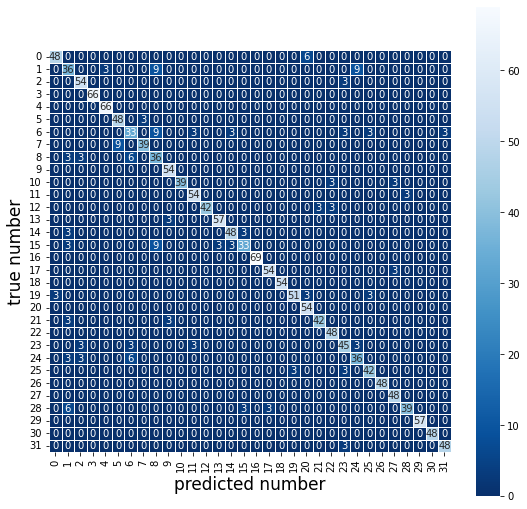

In [312]:
cm1 = metrics.confusion_matrix(y_test, ypred)

plt.figure(figsize=(9,9))
sns.heatmap(cm1, annot=True, fmt=".0f", linewidths=.5, square=True, cmap='Blues_r')
plt.ylabel('true number', size=17)
plt.xlabel('predicted number', size=17)
plt.show()

Search a beeter hyperparameters

In [99]:
from sklearn.model_selection import GridSearchCV

In [303]:
forest_params = [{'n_estimators':list(range(300,500,25))}]
rfc = RandomForestClassifier(random_state=0,max_features='log2')
clf = GridSearchCV(rfc, forest_params, cv = 3, scoring='accuracy')

clf.fit(X_new_train, y_train)

GridSearchCV(cv=3,
             estimator=RandomForestClassifier(max_features='log2',
                                              random_state=0),
             param_grid=[{'n_estimators': [300, 325, 350, 375, 400, 425, 450,
                                           475]}],
             scoring='accuracy')

In [304]:
print(clf.best_params_)
print(clf.best_score_)

{'n_estimators': 400}
0.8898050974512745


In [313]:
clf = RandomForestClassifier(random_state=0,max_features='log2',n_estimators=400)

clf.fit(X_new_train, y_train)


RandomForestClassifier(max_features='log2', n_estimators=400, random_state=0)

In [352]:
# measure the time of feature extraction
t=0
for i in range(100):
    t1 = time.time()
    X_new_test = feature_extract_data(X_br_test)
    t2 = time.time()
    t+= (t2-t1)
print(t/100)

118.03748333454132


In [348]:
t=0
for i in range(100):
    t1 = time.time()
    ypred = clf.predict(X_new_test)
    t2 = time.time()
    t+= (t2-t1)
print(t/100)


0.2263068985939026


In [314]:
ypred = clf.predict(X_new_test)

In [315]:
print(classification_report(y_test, ypred))

              precision    recall  f1-score   support

           0       1.00      0.94      0.97        54
           1       0.64      0.74      0.68        57
           2       0.86      1.00      0.93        57
           3       1.00      0.95      0.98        66
           4       0.96      1.00      0.98        66
           5       0.89      0.94      0.91        51
           6       0.75      0.63      0.69        57
           7       0.93      0.88      0.90        48
           8       0.59      0.62      0.61        48
           9       0.95      1.00      0.97        54
          10       0.93      0.87      0.90        45
          11       0.90      0.95      0.92        57
          12       0.93      0.88      0.90        48
          13       0.90      0.95      0.93        60
          14       0.89      0.94      0.92        54
          15       0.83      0.59      0.69        51
          16       1.00      1.00      1.00        69
          17       0.95    

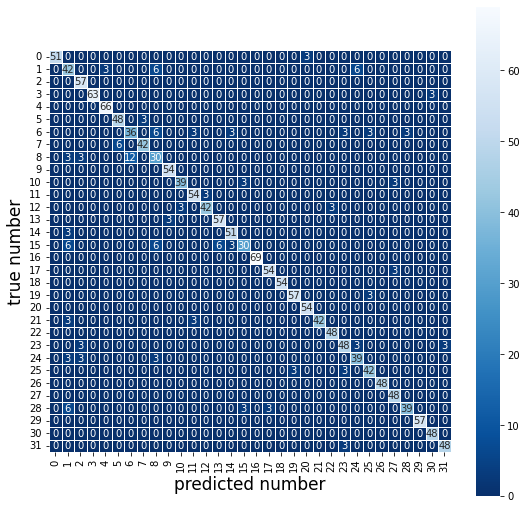

In [316]:
cm1 = metrics.confusion_matrix(y_test, ypred)

plt.figure(figsize=(9,9))
sns.heatmap(cm1, annot=True, fmt=".0f", linewidths=.5, square=True, cmap='Blues_r')
plt.ylabel('true number', size=17)
plt.xlabel('predicted number', size=17)
# plt.show()
plt.savefig('confusion.svg')

**Plot all misclassified samples**

total number of errors: 162


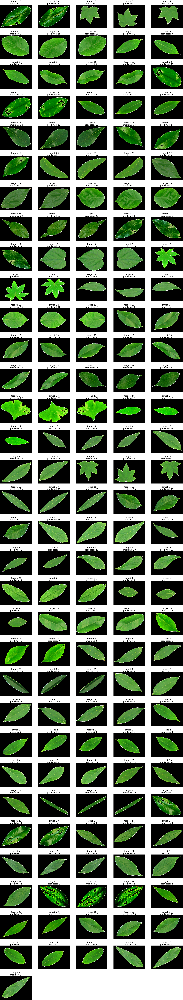

In [347]:
errors = (y_test-ypred != 0)
error_pos = np.array(np.where(errors))
print('total number of errors:', len(error_pos[0,:]))

# show the errors
plt.figure(figsize=(50,280))
x, y =5, 33
num=0
for i in range(1,162):  
    num+=1
    plt.subplot(y, x, num)
    idx = error_pos[0,i] 
    plt.imshow(X_br_test[idx].reshape(300,400,3),cmap='gray')
    plt.title('target: {}\npredicted: {}'.format(y_test[idx], ypred[idx]),fontsize=30)
    plt.axis('off')
# plt.show()
plt.savefig('FD_err.svg')

# Failed Trial

It contains some unsuccessful trails. The list is not complete as some are already deleted.

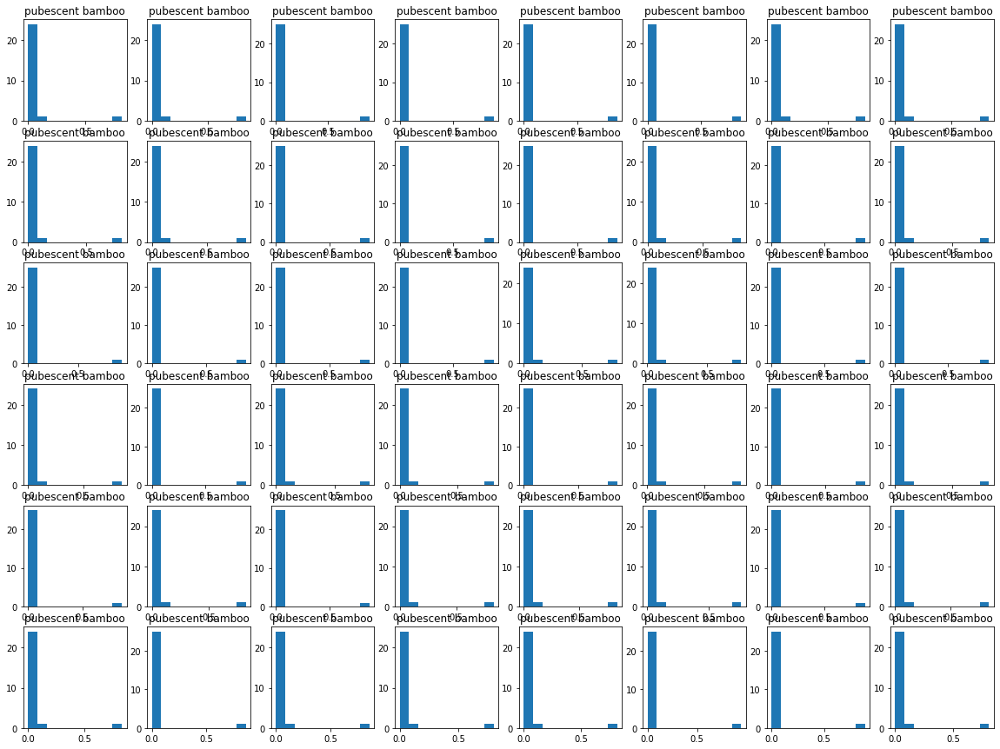

In [25]:
plt.figure(figsize=(20, 15))
for i in range(0,48):
    img = df[df['Target'] == 0].iloc[:,:-1].loc[i]
    img = np.array(img).reshape(300,400,3)
    img = background_substract(img)
    img = compute_lbp(img)
    ax = plt.subplot(6, 8, i + 1)
    plt.hist(img)
    plt.title(Categories[0])

In [63]:
from sklearn.svm import SVC  
clf = SVC() 
X_new_train = np.array(X_new_train)
clf.fit(X_new_train, y_train)

ypred = clf.predict(X_new_test)
print(classification_report(y_test, ypred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        54
           1       0.06      0.05      0.05        57
           2       0.00      0.00      0.00        57
           3       0.10      1.00      0.19        66
           4       0.18      0.77      0.30        66
           5       0.00      0.00      0.00        51
           6       0.00      0.00      0.00        57
           7       0.00      0.00      0.00        48
           8       0.00      0.00      0.00        48
           9       0.00      0.00      0.00        54
          10       0.00      0.00      0.00        45
          11       0.04      0.05      0.05        57
          12       0.00      0.00      0.00        48
          13       0.44      0.20      0.28        60
          14       0.00      0.00      0.00        54
          15       0.00      0.00      0.00        51
          16       0.68      1.00      0.81        69
          17       0.00    

/root/miniconda3/envs/d2l/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/root/miniconda3/envs/d2l/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/root/miniconda3/envs/d2l/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [144]:
print(
    f"Classification report for classifier {clf}:\n"
    f"{metrics.classification_report(y_test, ypred)}\n"
)

Classification report for classifier SVC():
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        54
           1       0.04      0.05      0.04        57
           2       0.00      0.00      0.00        57
           3       0.11      1.00      0.20        66
           4       0.21      0.91      0.34        66
           5       0.00      0.00      0.00        51
           6       0.00      0.00      0.00        57
           7       0.00      0.00      0.00        48
           8       0.00      0.00      0.00        48
           9       0.00      0.00      0.00        54
          10       0.00      0.00      0.00        45
          11       0.12      0.32      0.17        57
          12       0.00      0.00      0.00        48
          13       0.44      0.20      0.28        60
          14       0.00      0.00      0.00        54
          15       0.00      0.00      0.00        51
          16       0.92      1.00    

/root/miniconda3/envs/d2l/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/root/miniconda3/envs/d2l/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/root/miniconda3/envs/d2l/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [68]:
# PCA on Fourier
# X_FD_test = compute_FD(X_br_test,mode='fd')


from sklearn.decomposition import PCA

pca = PCA(n_components=99)
pca.fit(np.array(X_FD_train).reshape(4002,99))

print(pca.explained_variance_ratio_)



[7.64845003e-01 1.07195594e-01 4.76882719e-02 3.54423335e-02
 1.80868921e-02 1.40994399e-02 4.20833328e-03 2.80719963e-03
 1.35498280e-03 9.71320161e-04 7.35017057e-04 4.53004800e-04
 3.40604452e-04 2.64957593e-04 2.63586301e-04 1.70087894e-04
 1.59496542e-04 1.29881718e-04 1.11446484e-04 8.74190621e-05
 6.76694644e-05 6.17182250e-05 5.16572104e-05 4.54535233e-05
 3.31721098e-05 2.81261867e-05 2.41614304e-05 2.08568945e-05
 1.82392577e-05 1.62836000e-05 1.51957850e-05 1.36851696e-05
 1.28988513e-05 1.09661822e-05 1.02526361e-05 9.61849619e-06
 8.74274145e-06 8.21807745e-06 7.74001203e-06 7.32903465e-06
 6.66027292e-06 6.06510229e-06 5.58882229e-06 5.20163734e-06
 4.98413110e-06 4.55156355e-06 4.01855479e-06 3.96559992e-06
 3.76919804e-06 3.63049850e-06 3.50080252e-06 3.13615035e-06
 2.93059698e-06 2.80117986e-06 2.71044527e-06 2.65039807e-06
 2.54880288e-06 2.30531742e-06 2.15146661e-06 2.14151244e-06
 1.98662822e-06 1.90192437e-06 1.77182355e-06 1.65809231e-06
 1.58139512e-06 1.540745

### Gradient Boosting Classifier

In [81]:
from sklearn.ensemble import GradientBoostingClassifier

In [84]:
clf = GradientBoostingClassifier(random_state=0).fit(df_train, y_train)


0.8045375218150087

In [85]:
clf.score(df_train, y_train)

1.0

In [86]:
clf.score(df_test, y_test)

0.8045375218150087

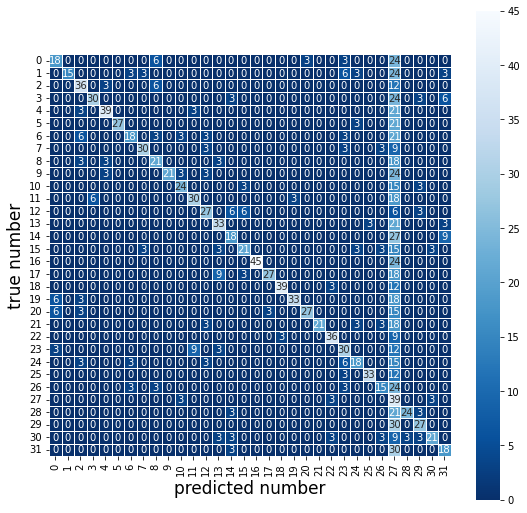

In [87]:
cm1 = metrics.confusion_matrix(y_test, ypred)

plt.figure(figsize=(9,9))
sns.heatmap(cm1, annot=True, fmt=".0f", linewidths=.5, square=True, cmap='Blues_r')
plt.ylabel('true number', size=17)
plt.xlabel('predicted number', size=17)
plt.show()

In [88]:
from sklearn.neural_network import MLPClassifier

In [90]:
clf = MLPClassifier(random_state=0, max_iter=300).fit(df_train, y_train)

/root/miniconda3/envs/d2l/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


In [93]:
print(f'train score: ', clf.score(df_train, y_train))
print(f'test score: ' ,clf.score(df_test, y_test))

train score:  0.34907546226886554
test score:  0.3507853403141361
